In [2]:
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import glob
import os
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter,LatitudeFormatter
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
import cmap
import cartopy.feature as cFeature

## Load climate index variables for specified area and model run

In [ ]:
# Define dataset specifics

model_scenario_name = 'MRI-ESM2-0_ssp245' # Choose a model and SSP scenario
area_name = 'germany' # Choose an area
data_folder = '../climatic_indices/' # Folder where computed climate indices are stored


# Defines start and end of time slice by picking 20 years before and 20 years after abrupt SPG cooling
if model_scenario_name == 'NorESM2-LM_ssp126':
    start_time = '2015-01-01'; end_time = '2055-01-01'
    time_array = np.arange(2015, 2055, 1)
elif model_scenario_name == 'NorESM2-LM_ssp245':
    start_time = '2015-01-01'; end_time = '2055-01-01'
    time_array = np.arange(2015, 2055, 1)
elif model_scenario_name == 'CESM2-WACCM_ssp126':
    start_time = '2020-01-01'; end_time = '2060-01-01'
    time_array = np.arange(2020, 2060, 1)
elif model_scenario_name == 'CESM2-WACCM_ssp245':
    start_time = '2020-01-01'; end_time = '2060-01-01'
    time_array = np.arange(2020, 2060, 1)
elif model_scenario_name == 'MRI-ESM2-0_ssp245':
    start_time = '2020-01-01'; end_time = '2060-01-01'
    time_array = np.arange(2020, 2060, 1)
elif model_scenario_name == 'MPI-ESM1-2-LR_ssp245':
    start_time = '2015-01-01'; end_time = '2060-01-01'
    cooling_year = '2040-01-01'
    time_array = np.arange(2015, 2060, 1)
elif model_scenario_name == 'GFDL-ESM4_ssp245':
    start_time = '2020-01-01'; end_time = '2060-01-01'
    cooling_year = '2040-01-01'
else:
    print("This dataset is not considered in the current study, but can be added to the analysis")


# Load climate indicies

clim_idx = xr.open_mfdataset(data_folder+'*_'+area_name+'_'+model_scenario_name+'.nc', decode_timedelta=False)
clim_idx.load()


<xarray.Dataset> Size: 312kB
Dimensions:  (lat: 8, lon: 9, time: 45)
Coordinates:
  * lat      (lat) float64 64B 46.54 47.66 48.78 49.91 51.03 52.15 53.27 54.39
  * lon      (lon) float64 72B 5.625 6.75 7.875 9.0 10.12 11.25 12.38 13.5 14.62
  * time     (time) int64 360B 2015 2016 2017 2018 2019 ... 2056 2057 2058 2059
Data variables:
    CDD      (lat, lon, time) float64 26kB 37.0 22.0 17.0 ... 25.0 23.0 16.0
    CWD      (lat, lon, time) float64 26kB 15.0 15.0 17.0 15.0 ... 12.0 9.0 13.0
    FD       (lat, lon, time) float64 26kB nan nan nan nan ... 0.0 1.0 8.0 0.0
    GDD_v2   (lat, lon, time) float64 26kB nan nan nan ... 2.529e+03 2.539e+03
    PRCPTOT  (lat, lon, time) float64 26kB 1.459e+03 1.237e+03 ... 769.3 831.0
    R10mm    (lat, lon, time) float64 26kB 47.0 40.0 38.0 ... 20.0 19.0 21.0
    R1mm     (lat, lon, time) float64 26kB 182.0 174.0 186.0 ... 121.0 135.0
    R20mm    (lat, lon, time) float64 26kB 14.0 12.0 9.0 11.0 ... 3.0 5.0 4.0
    RX5day   (lat, lon, time) float64 26kB 88.57 82.48 96.12 ... 65.46 80.3
    SDII     (lat, lon, time) float64 26kB 7.894 6.948 6.946 ... 5.964 5.749
    TNmin    (lat, lon, time) float64 26kB nan nan nan ... -0.4734 -1.255 0.6597
    TR       (lat, lon, time) float64 26kB nan nan nan nan ... 28.0 17.0 2.0

## Plot timeseries for specific grid point

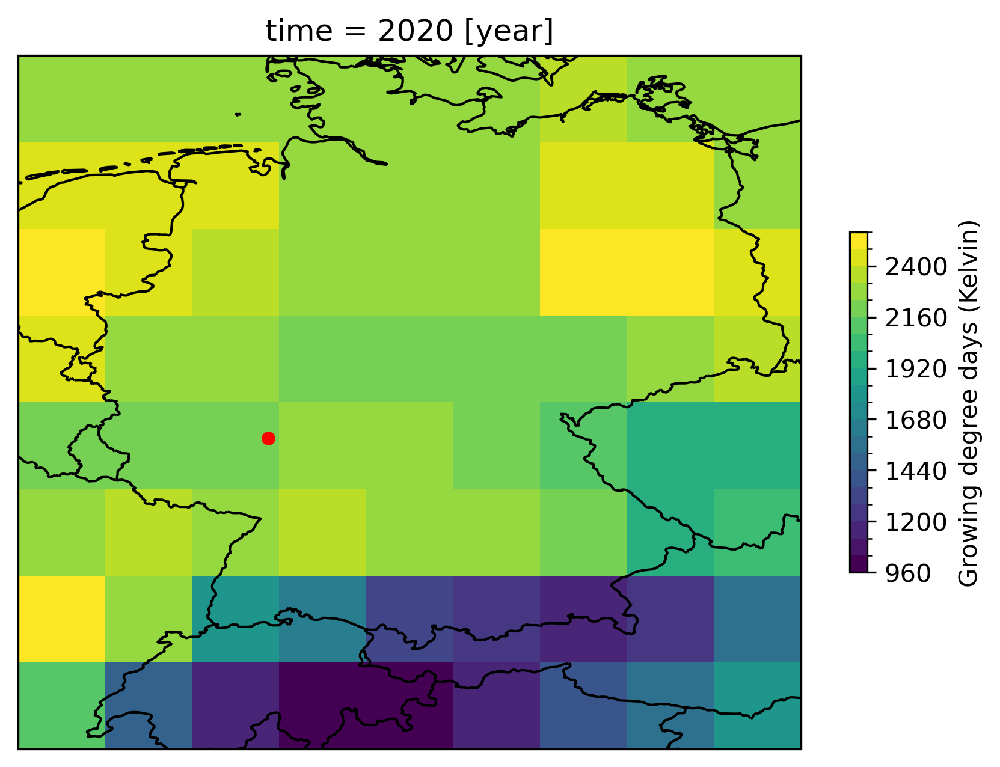

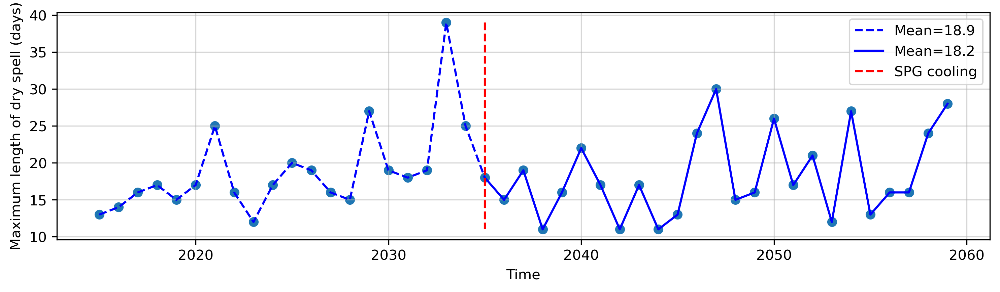

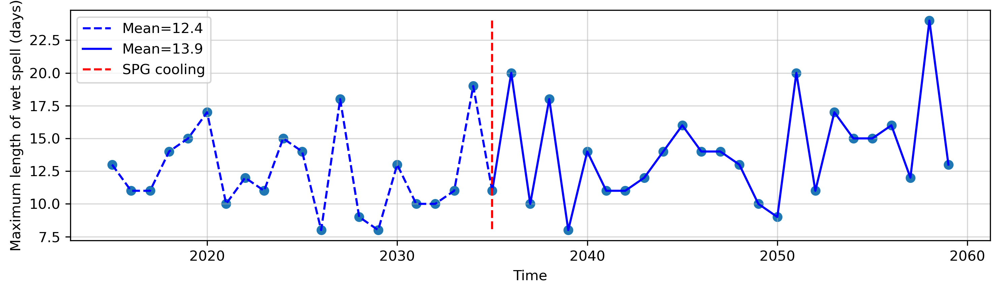

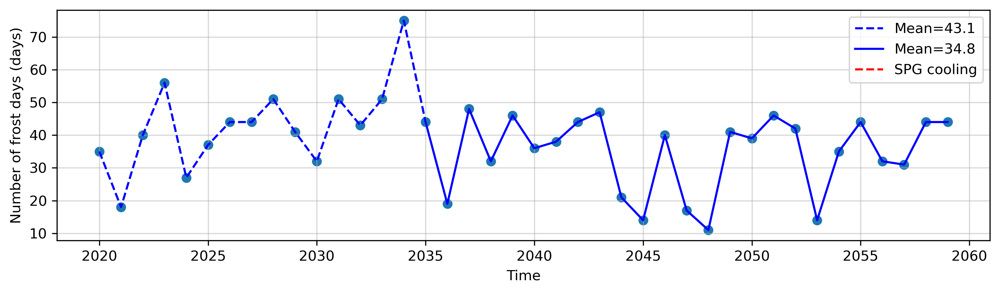

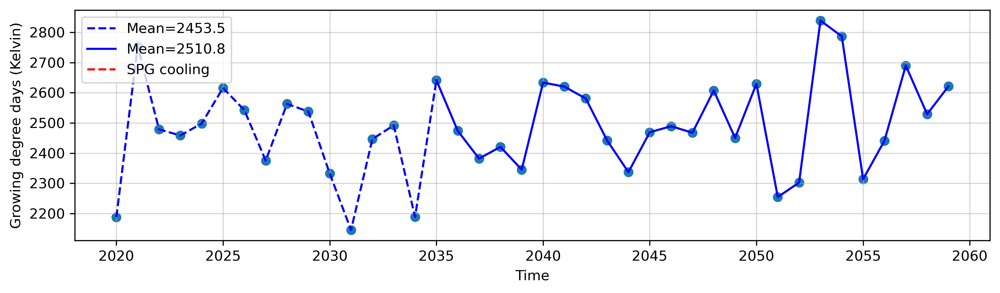

...

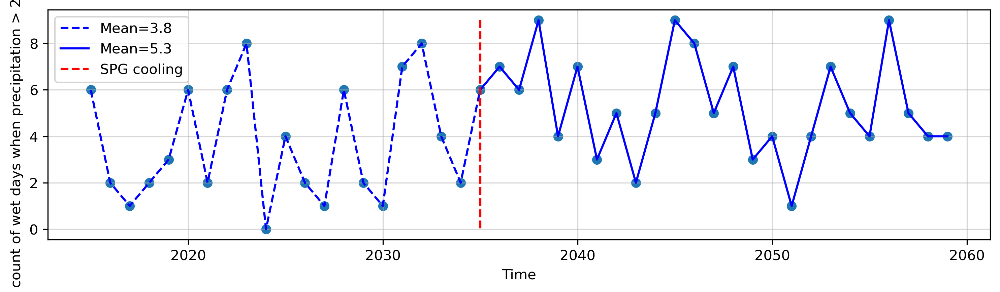

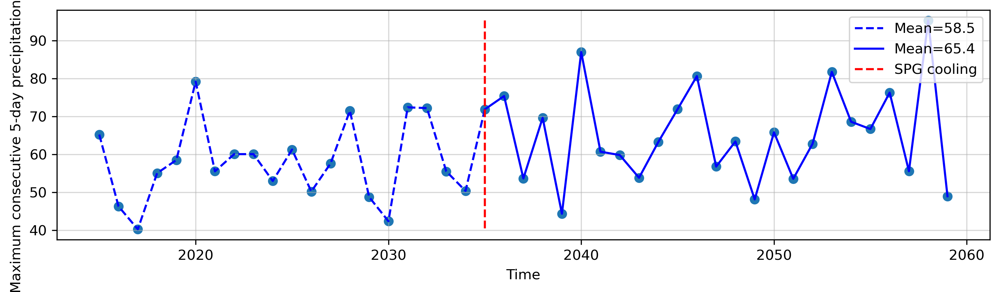

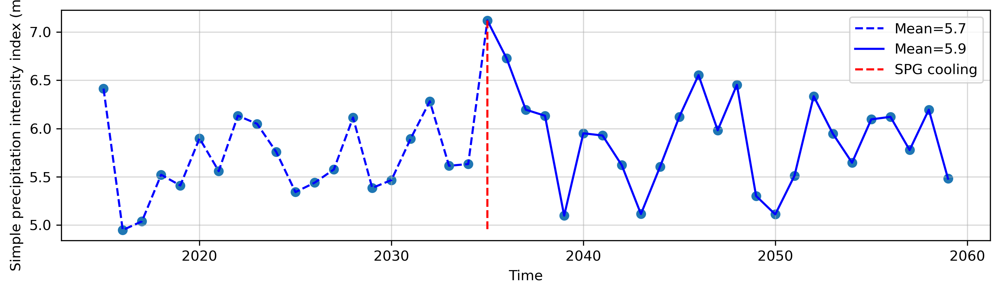

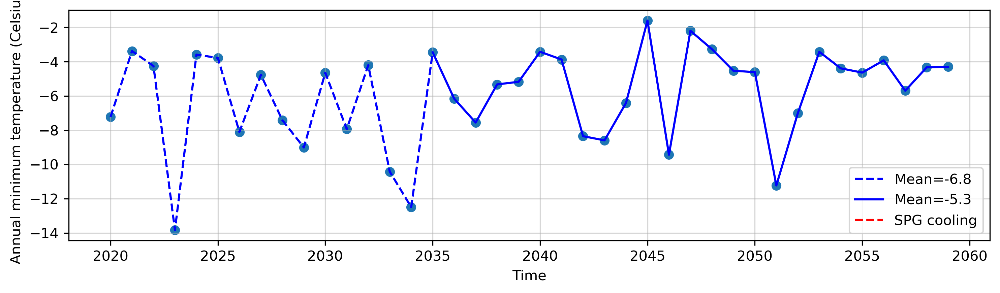

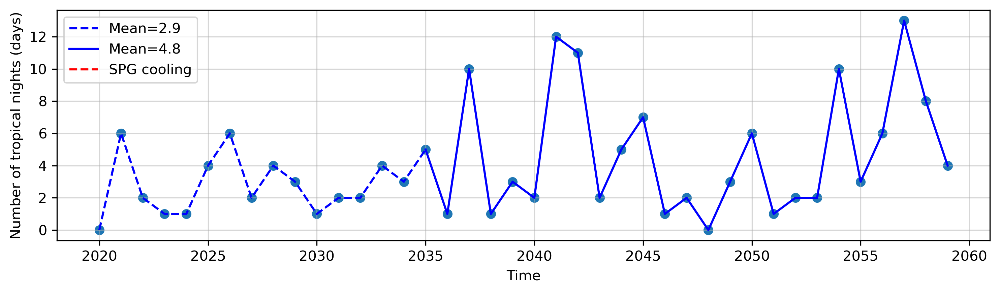

In [4]:
save_folder = '../figures/time_series/' # Folder where figures should be saved
os.makedirs(save_folder, exist_ok=True) 

# Choose grid point

point_name = 'Mainz'
if point_name == 'Hamar':
    lat = 61; lon = 11
elif point_name == 'Mainz':
    lat = 50; lon = 8.3

# Choose variables

variable_list = list(clim_idx.keys())

# Plot map of grid point
variable_name = 'GDD_v2'
da = xr.open_dataset(data_folder+variable_name+'_'+area_name+'_'+model_scenario_name+'.nc', decode_timedelta={variable_name : False})
fig = plt.figure(1, figsize=(7,7),dpi=300)
ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
data = da[variable_name].isel(time=0)
map = data.plot(ax=ax, 
                transform=ccrs.PlateCarree(),levels=21, 
                cbar_kwargs={'orientation':'vertical','shrink':0.35, 'aspect':20,'label':clim_idx[variable_name].description +' ('+clim_idx[variable_name].units+')'})
ax.coastlines()
ax.add_feature(cFeature.BORDERS)
ax.scatter(lon, lat, s=20, c='r', marker='o', linewidths=1, transform=ccrs.PlateCarree())

# Plotting

for variable in variable_list:
    fig = plt.figure(figsize=[10, 3],dpi=300)
    values = clim_idx[variable].sel(lat=lat, lon=lon, method='nearest')
    plt.scatter(clim_idx.time, values)
    plt.plot(clim_idx.time[:21], values[:21], color='blue',linestyle='--', label='Mean='+str(np.round(float(np.mean(values[:21])),1)))
    plt.plot(clim_idx.time[20:], values[20:], color='blue',linestyle='-', label='Mean='+str(np.round(float(np.mean(values[20:])),1)))
    plt.vlines(clim_idx.time[0]+20, max(values), min(values), color='red', linestyle='--', label='SPG cooling')
    plt.xlabel('Time')
    plt.ylabel(clim_idx[variable].description +' ('+clim_idx[variable].units+')')
    plt.grid(alpha=0.5)
    plt.legend()
    fig.tight_layout()
    plt.savefig(save_folder+variable+'_'+point_name+'.png')
    plt.show()


## Plot difference maps of climate indices comparing mean to mean

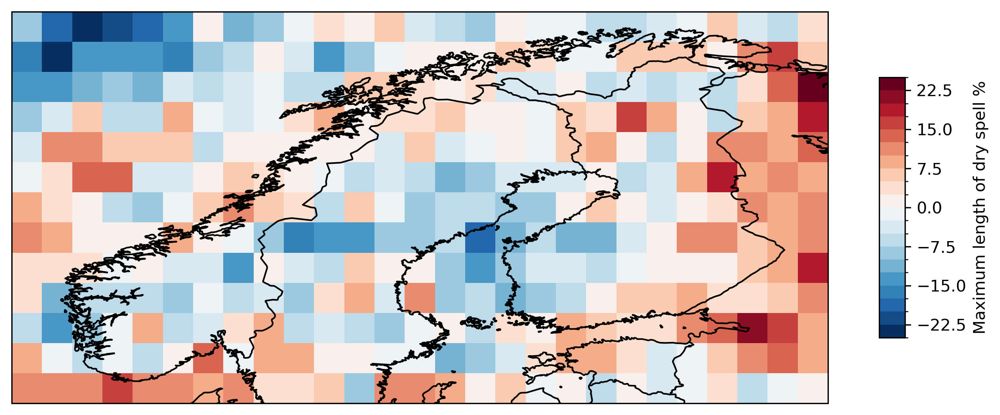

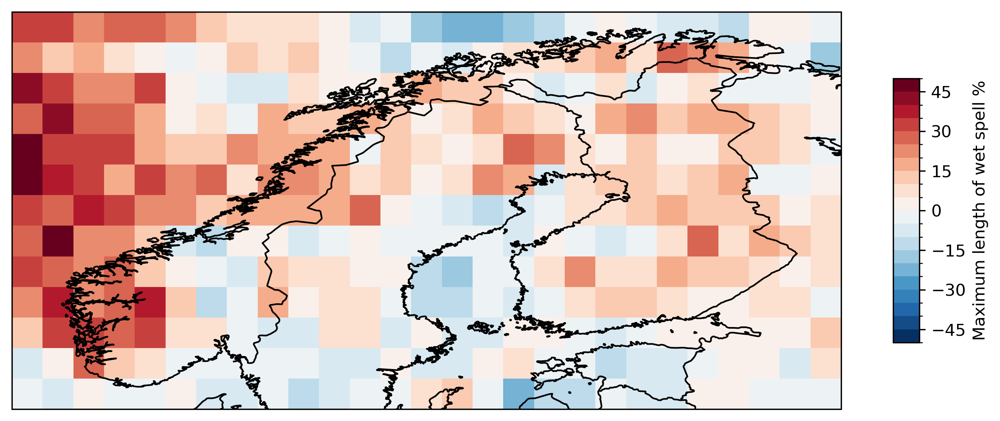

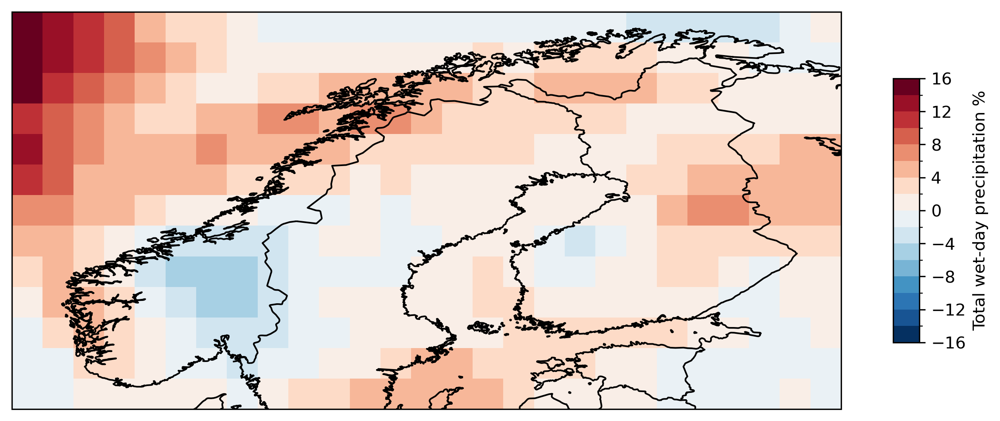

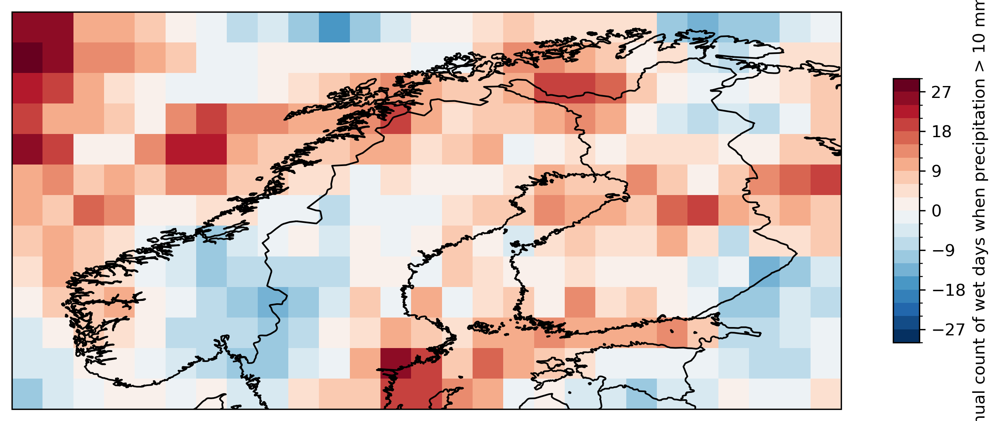

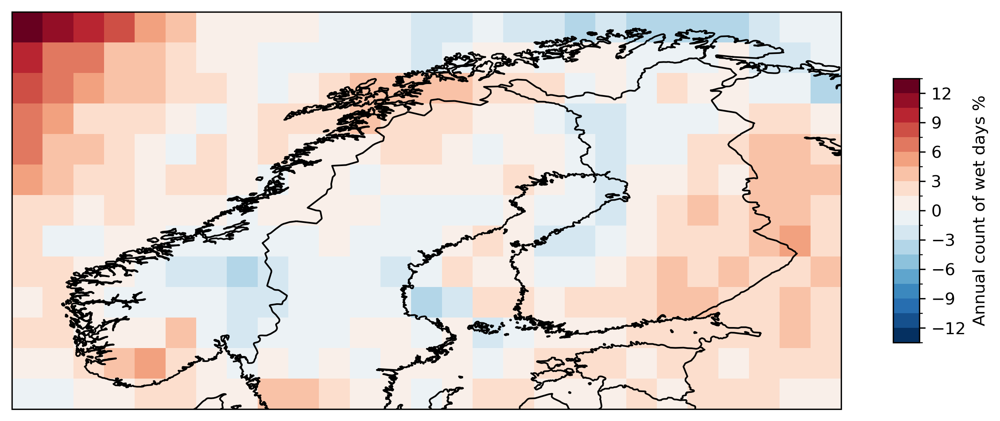

...

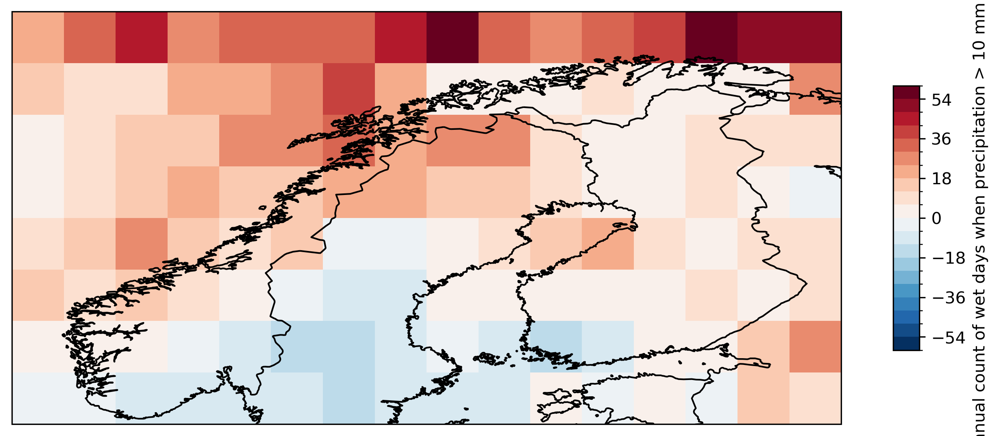

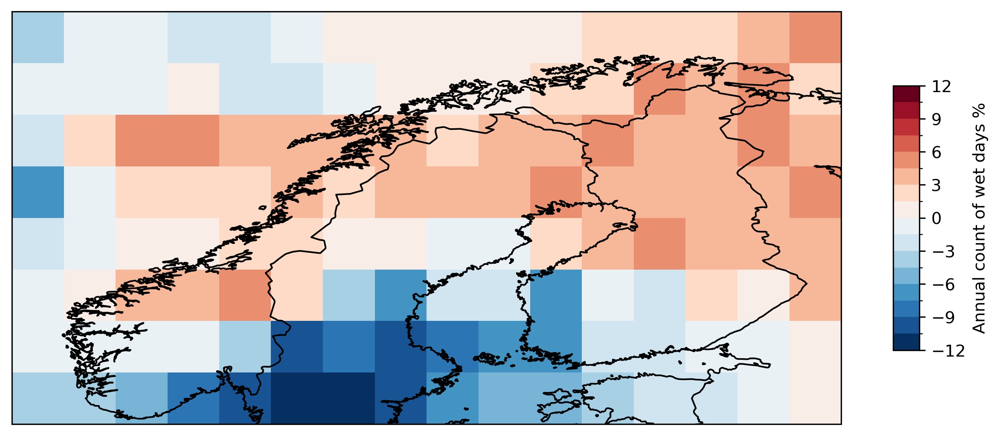

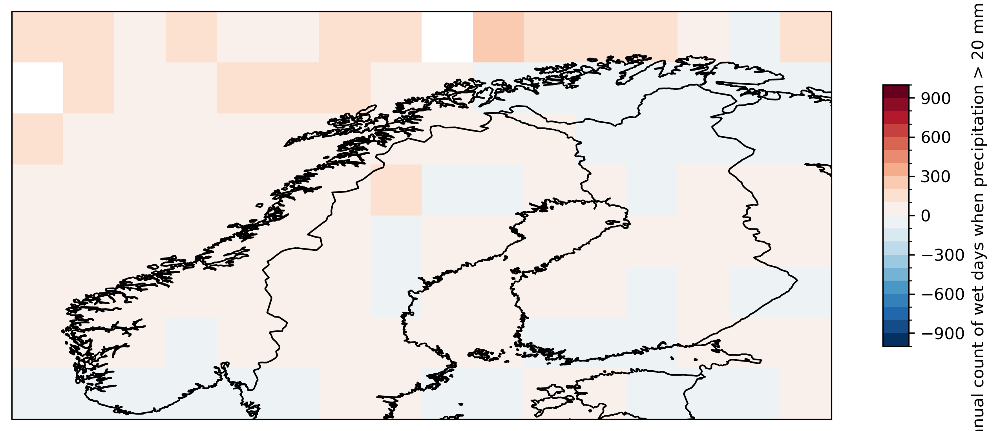

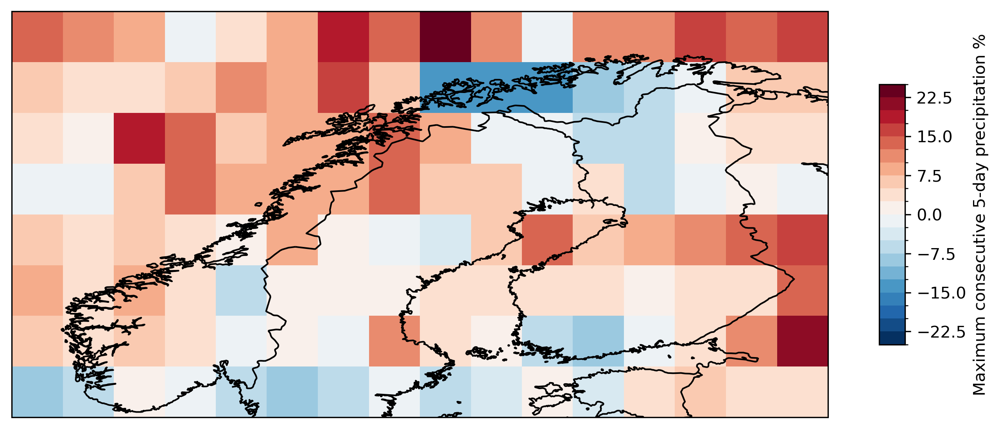

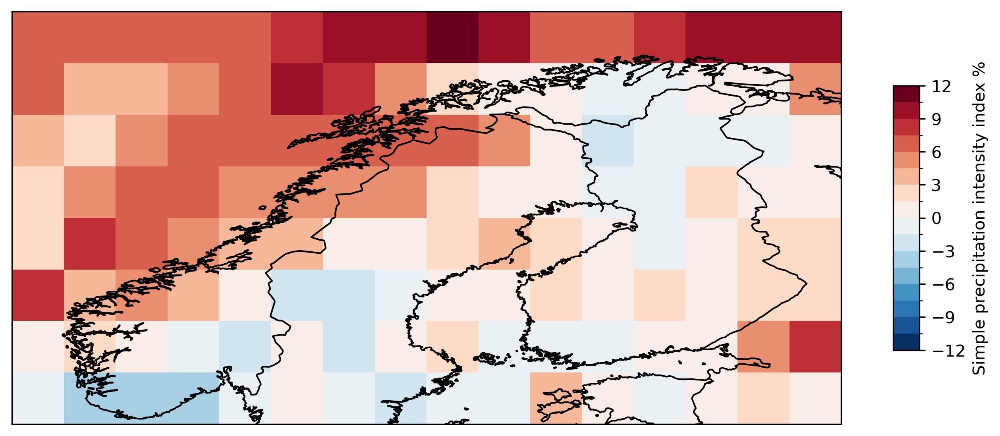

In [ ]:
save_folder = '../figures/maps/' # Folder where figures should be saved
os.makedirs(save_folder, exist_ok=True) 

# Choose model scenario and area

data_folder = '../climatic_indices/' # Folder where climate index data is stored
area_name = 'norway' # Choose area
model_scenario_names = ['MRI-ESM2-0_ssp245', 'MPI-ESM1-2-LR_ssp245'] # Choose model scenario
reldiff = True # Choose whether to plot relative difference or not


for model_scenario_name in model_scenario_names:
    clim_idx = xr.open_mfdataset(data_folder+'*_'+area_name+'_'+model_scenario_name+'.nc', decode_timedelta=False)
    clim_idx.load()

    # Choose variables

    variable_list = list(clim_idx.keys())

    # Plotting

    for variable in variable_list:
        levels = 21
        if reldiff == True:
            label = ' %'
        fig = plt.figure(figsize=[9, 4], dpi=300)
        ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
        ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
        diff = clim_idx[variable].isel(time=slice(25,45)).mean("time") - clim_idx[variable].isel(time=slice(0,20)).mean("time")
        if area_name == 'europe':
            diff = diff.reindex({'lon':np.arange(0, 360, clim_idx.lon[1]-clim_idx.lon[0])})
            ax.set_xlim([-15, 18])
        if reldiff == True:
            diff = diff/ clim_idx[variable].isel(time=slice(0,20)).mean("time") * 100
            label = clim_idx[variable].description + label
        else:
            label = clim_idx[variable].description + clim_idx[variable].unit
        map = diff.plot(ax=ax, 
                    transform=ccrs.PlateCarree(),levels=levels, cmap='RdBu_r',
                    cbar_kwargs={'orientation':'vertical','shrink':0.6, 'aspect':10,'label':label})
        ax.coastlines()
        ax.add_feature(cFeature.BORDERS)
        fig.tight_layout()
        if reldiff == True:
            plt.savefig(save_folder+'reldiff_'+variable+'_'+area_name+'_'+model_scenario_name+'.png')
        else:
            plt.savefig(save_folder+'diff_'+variable+'_'+area_name+'_'+model_scenario_name+'.png')
        plt.show()


## Plot minimum year to minimum year

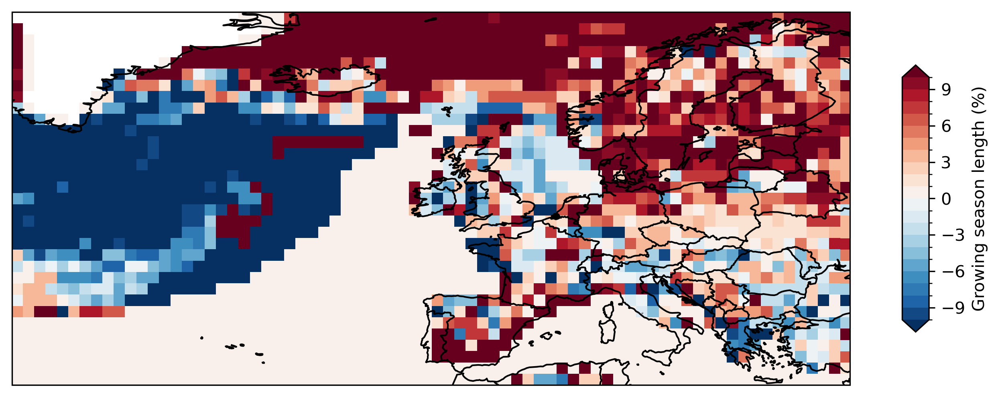

In [ ]:
save_folder = '../figures/maps/' # Folder where figures should be saved
os.makedirs(save_folder, exist_ok=True) 

# Choose variables

variable_list = list(clim_idx.keys())
level_list = [5, 2, 5, 10, 100, 20, 20, 10, 30, 5, 5, 5, 10, 1, 5, 5, 5, 5, 2] 
reldiff = 'True'

# Plotting

for variable, lmax in zip(variable_list, level_list):
    levels = np.linspace(-lmax, lmax, 21)
    fig = plt.figure(figsize=[9, 4], dpi=300)
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
    diff = clim_idx[variable].isel(time=slice(20,40)).min("time") - clim_idx[variable].isel(time=slice(0,20)).min("time")
    if area_name == 'europe':
        diff = diff.reindex({'lon':np.arange(0, 360, clim_idx.lon[1]-clim_idx.lon[0])})
        ax.set_xlim([-50, 33])
    if reldiff:
        diff = diff/ clim_idx[variable].isel(time=slice(0,20)).mean("time") * 100
        label = clim_idx[variable].description +' (%)'
    else:
        label = clim_idx[variable].description
    map = diff.plot(ax=ax, 
                transform=ccrs.PlateCarree(),levels=levels, cmap='RdBu_r',
                cbar_kwargs={'orientation':'vertical','shrink':0.6, 'aspect':10,'label':label})
    ax.coastlines()
    ax.add_feature(cFeature.BORDERS)
    fig.tight_layout()
    if reldiff:
        plt.savefig(save_folder+'reldiff_'+variable+'_min_'+area_name+'_'+model_scenario_name+'.png')
    else:
        plt.savefig(save_folder+variable+'_min_'+area_name+'_'+model_scenario_name+'.png')
    plt.show()

## Plot maximum year to maximum year

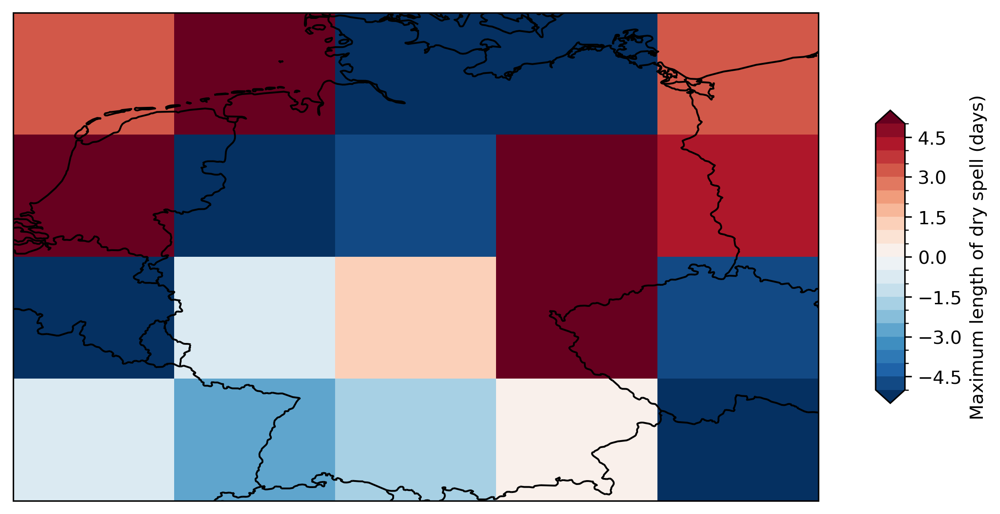

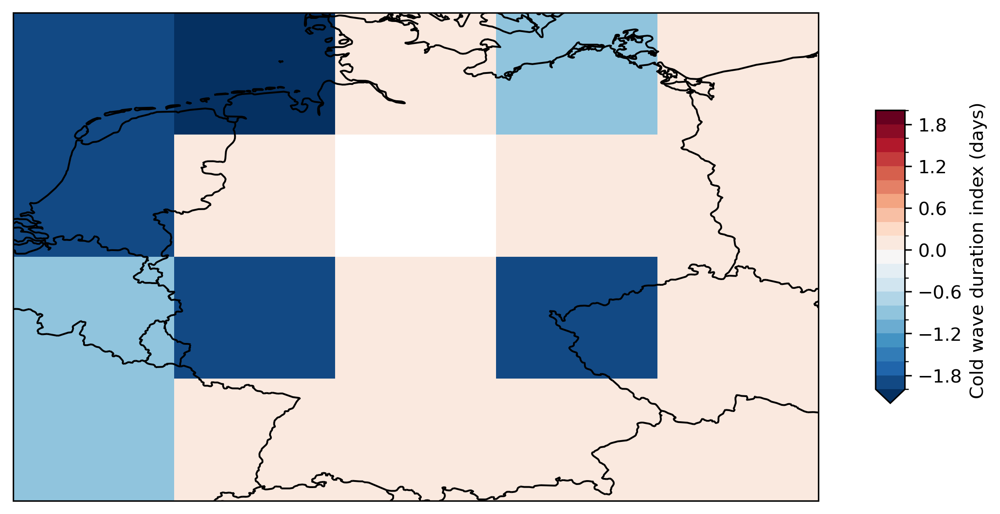

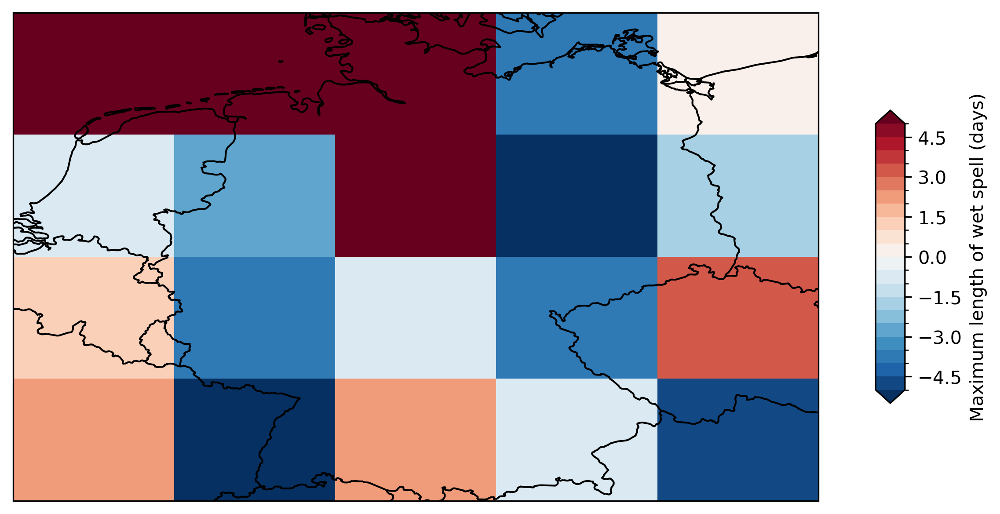

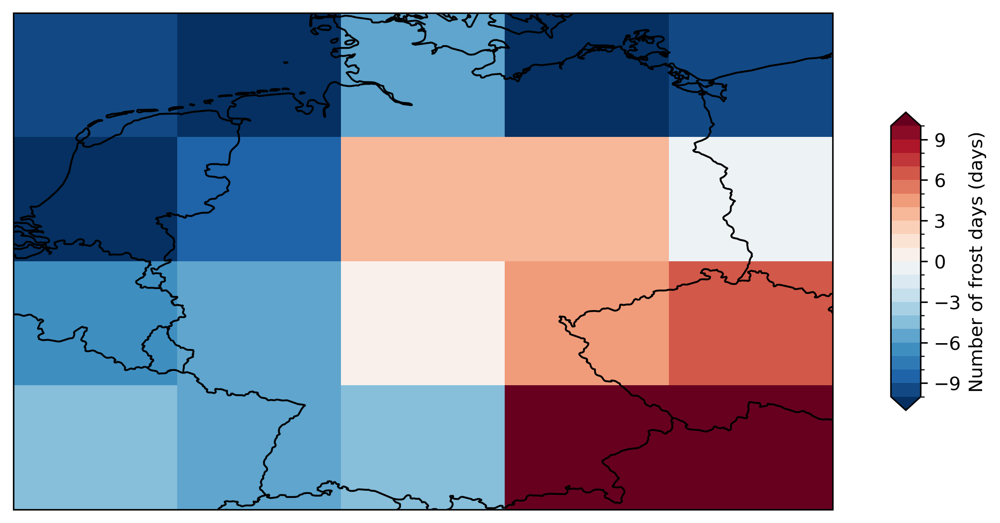

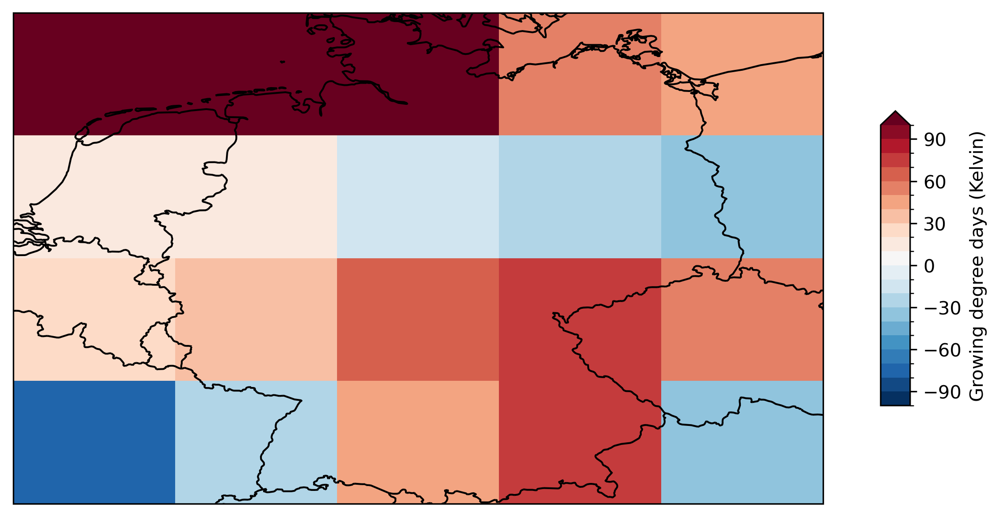

...

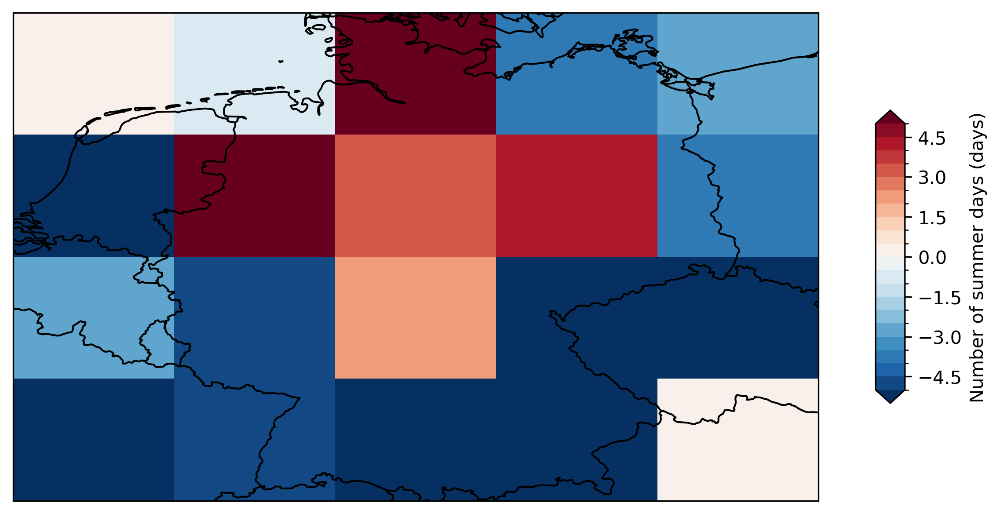

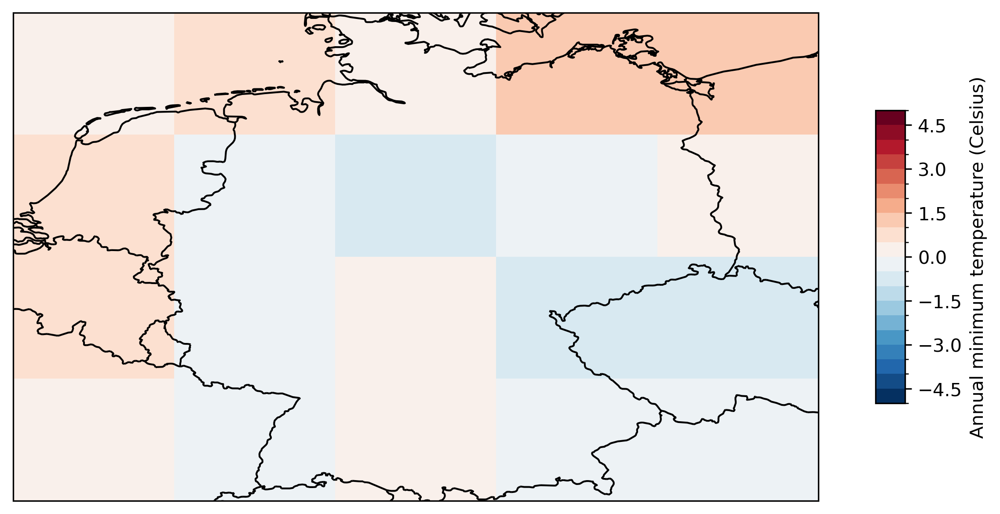

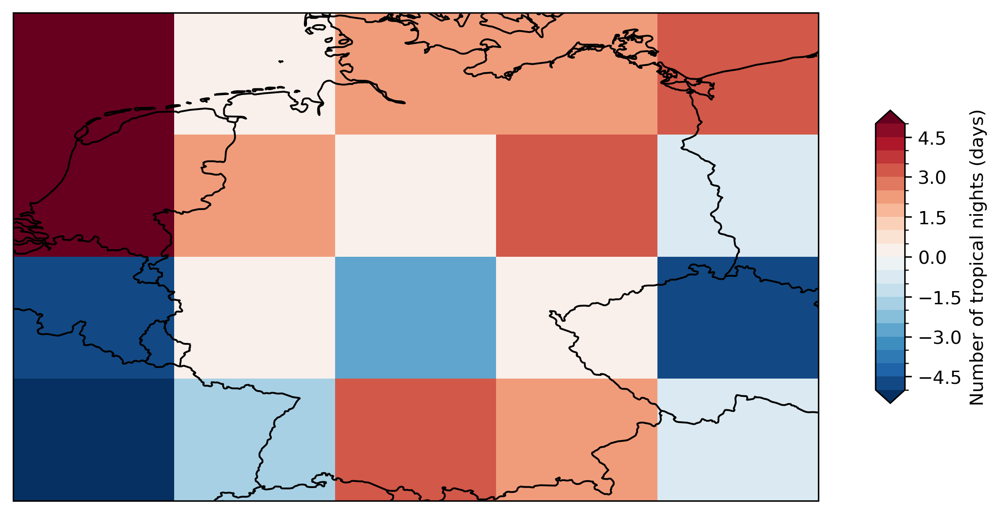

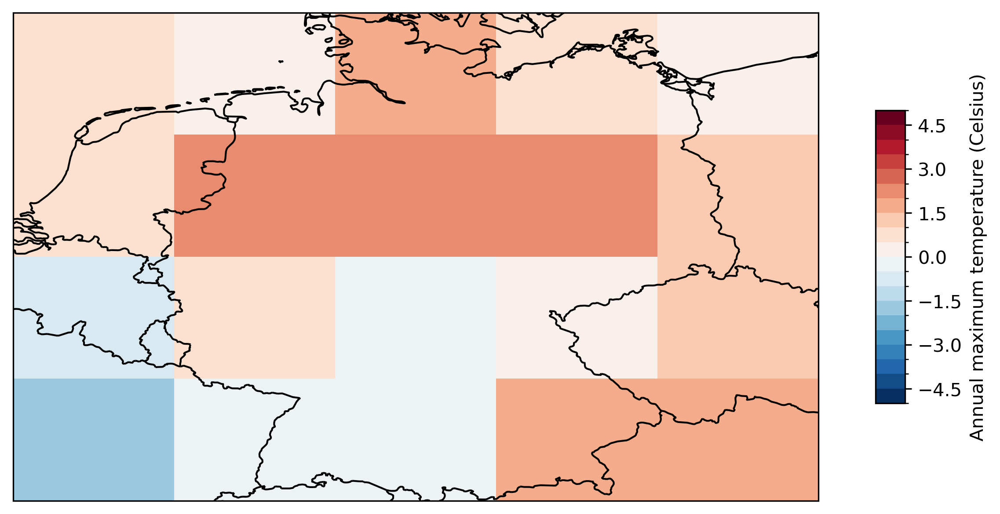

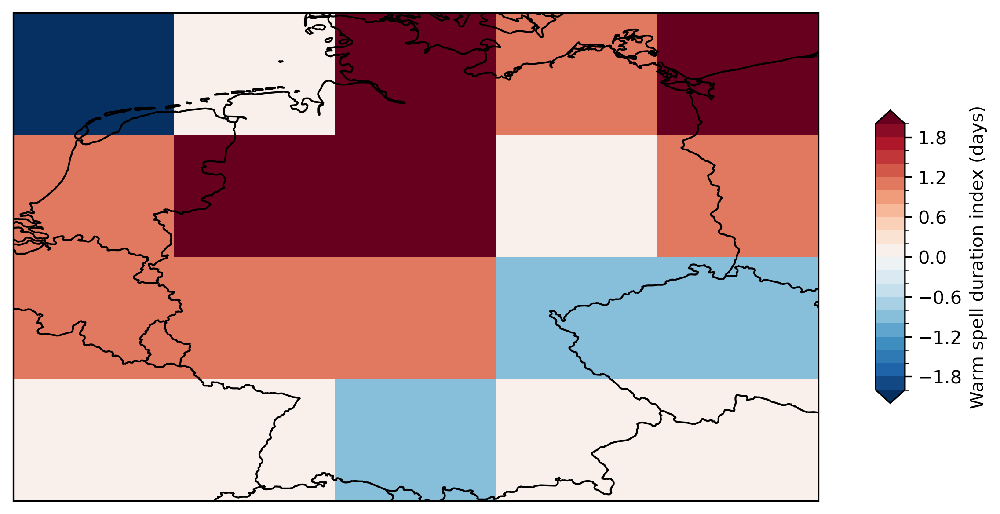

In [ ]:
save_folder = '../figures/maps/' # Folder where figures should be saved
os.makedirs(save_folder, exist_ok=True) 

# Choose variables

variable_list = list(clim_idx.keys())
levels = 21

# Plotting

for variablex in variable_list:
    fig = plt.figure(figsize=[9, 4], dpi=300)
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
    ax = plt.subplot(1,1,1, projection=ccrs.PlateCarree())
    diff = clim_idx[variable].isel(time=slice(20,40)).max("time") - clim_idx[variable].isel(time=slice(0,20)).max("time")
    map = diff.plot(ax=ax, 
                transform=ccrs.PlateCarree(),levels=levels, cmap='RdBu_r',
                cbar_kwargs={'orientation':'vertical','shrink':0.6, 'aspect':10,'label':clim_idx[variable].description +' ('+clim_idx[variable].units+')'})
    ax.coastlines()
    ax.add_feature(cFeature.BORDERS)
    fig.tight_layout()
    plt.savefig(save_folder+variable+'_max_'+area_name+'_'+model_scenario_name+'.png')
    plt.show()

## Plot maps on globe

['FD', 'GDD', 'ID', 'PRCPTOT', 'R10mm', 'R1mm', 'R20mm', 'RX5day', 'SDII', 'SU', 'TNmin', 'TR', 'TXmax']


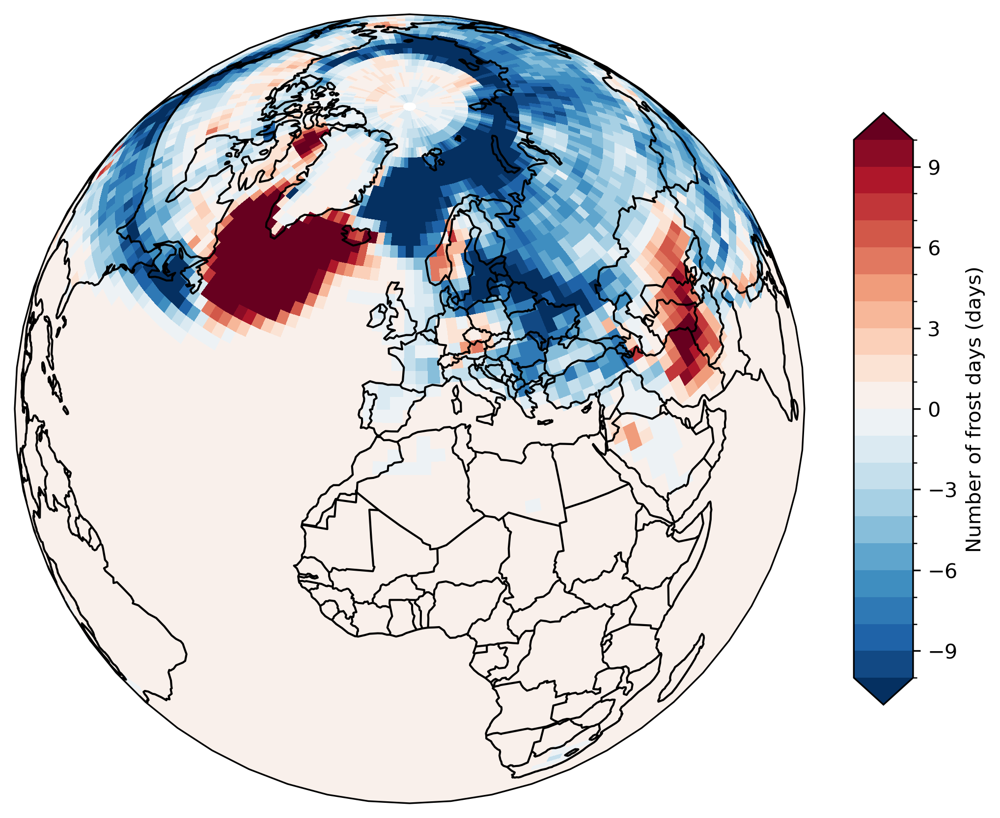

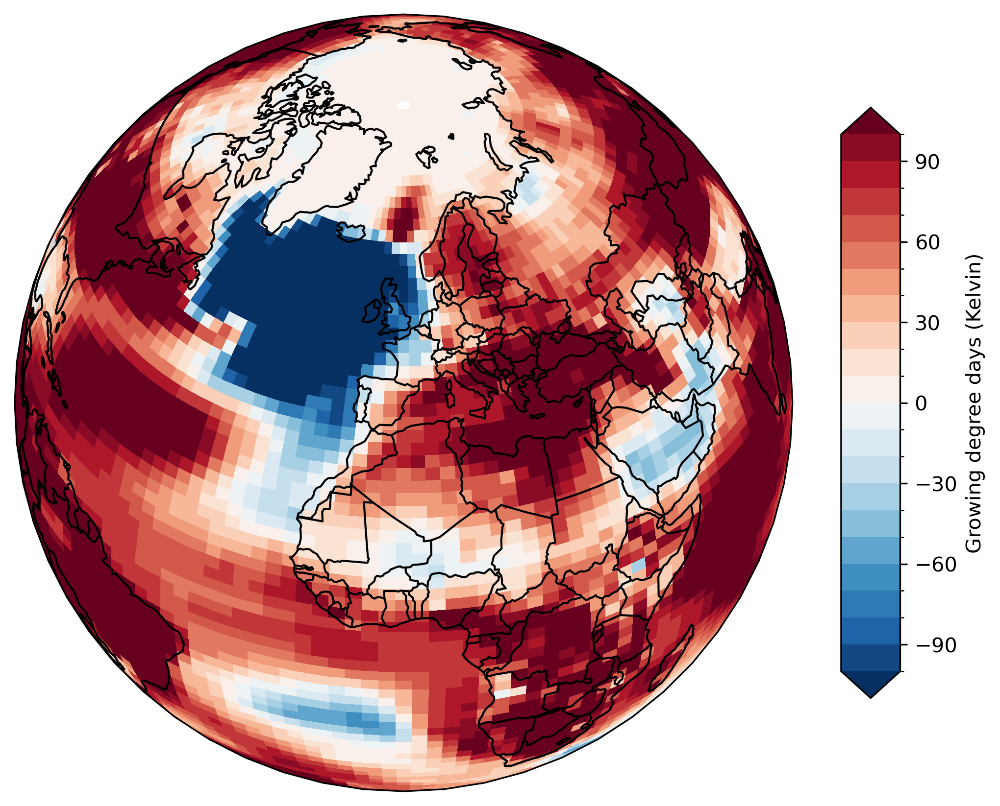

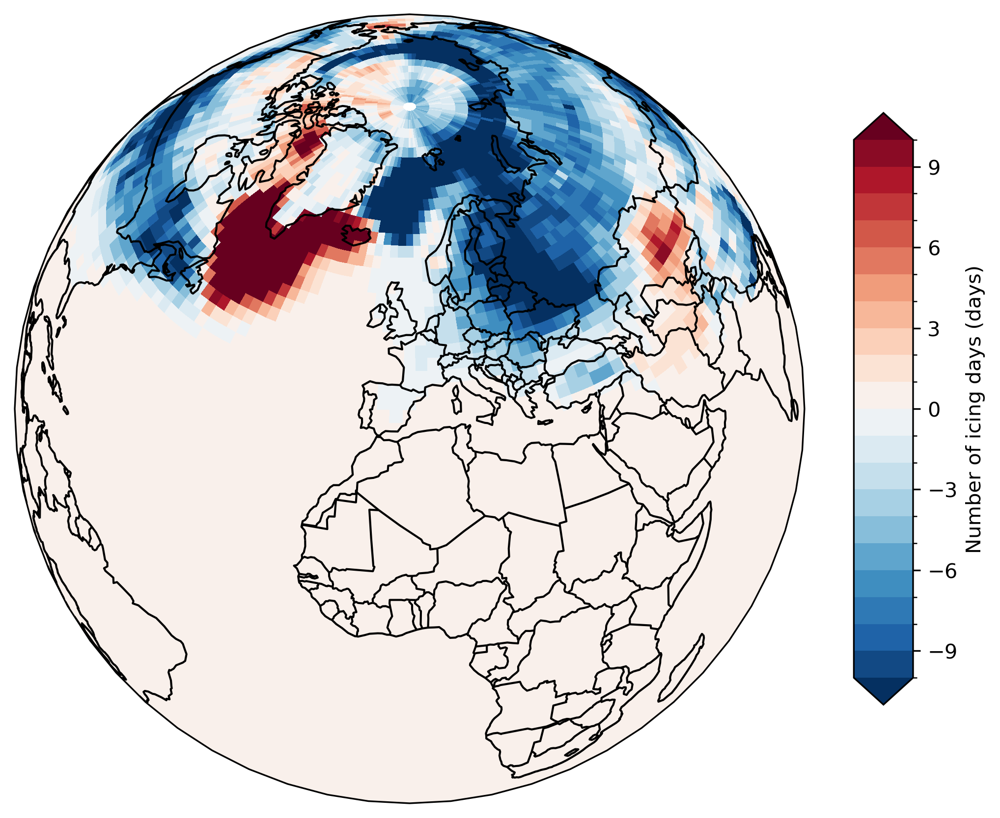

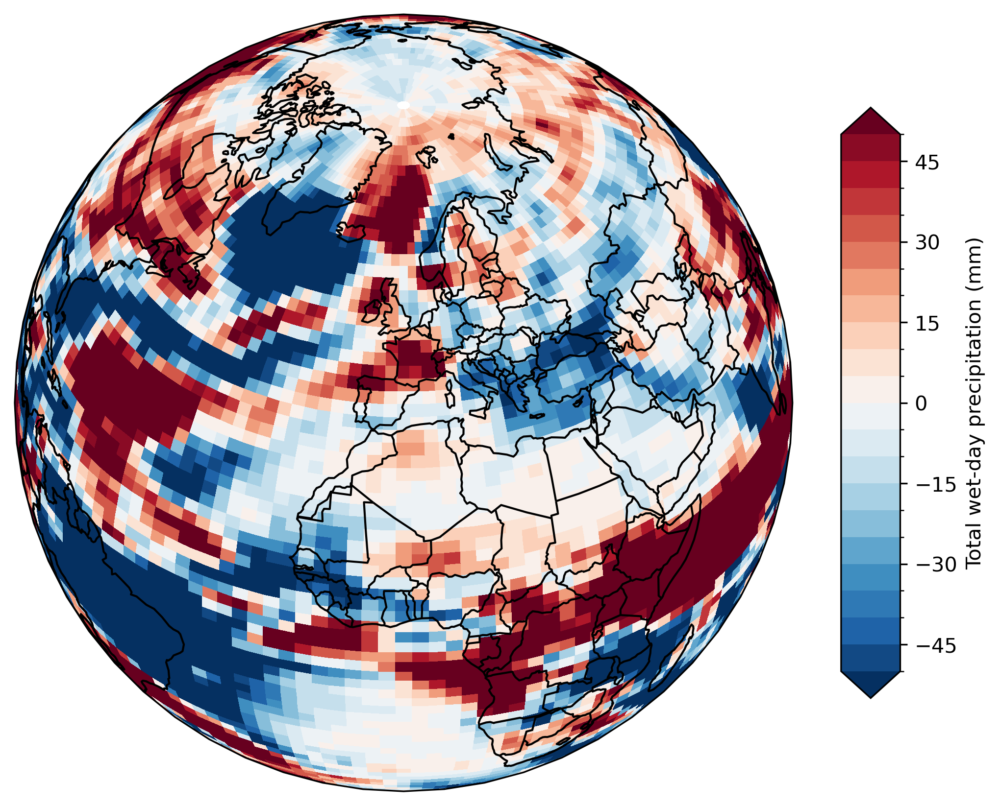

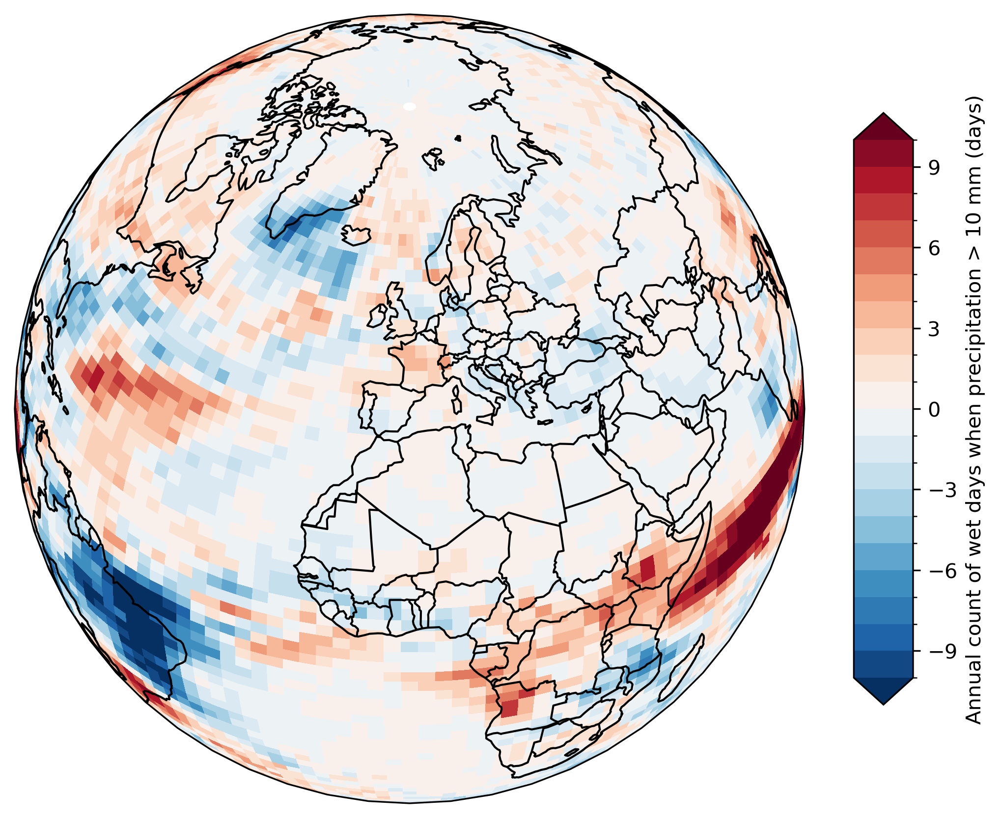

...

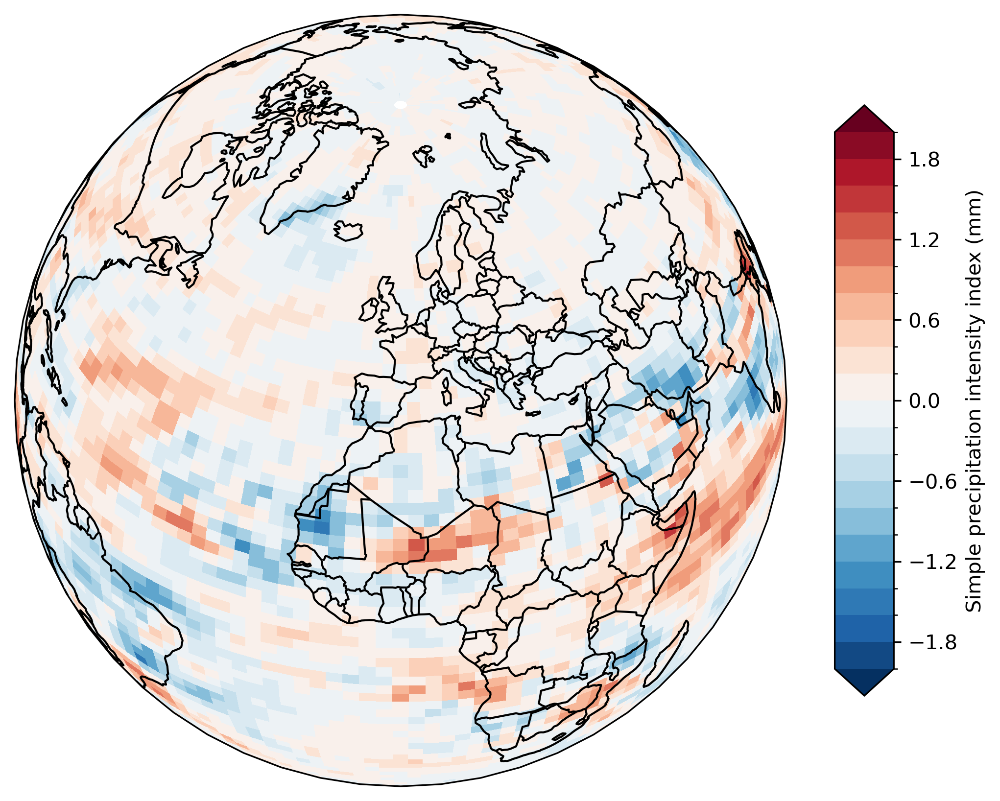

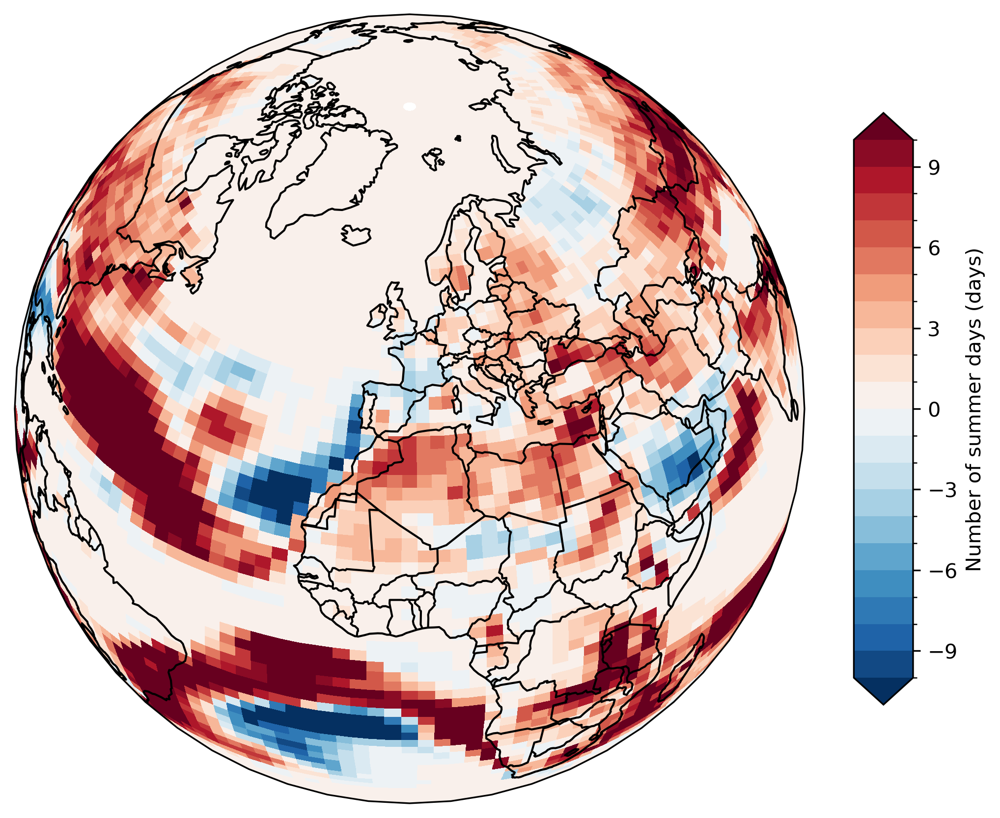

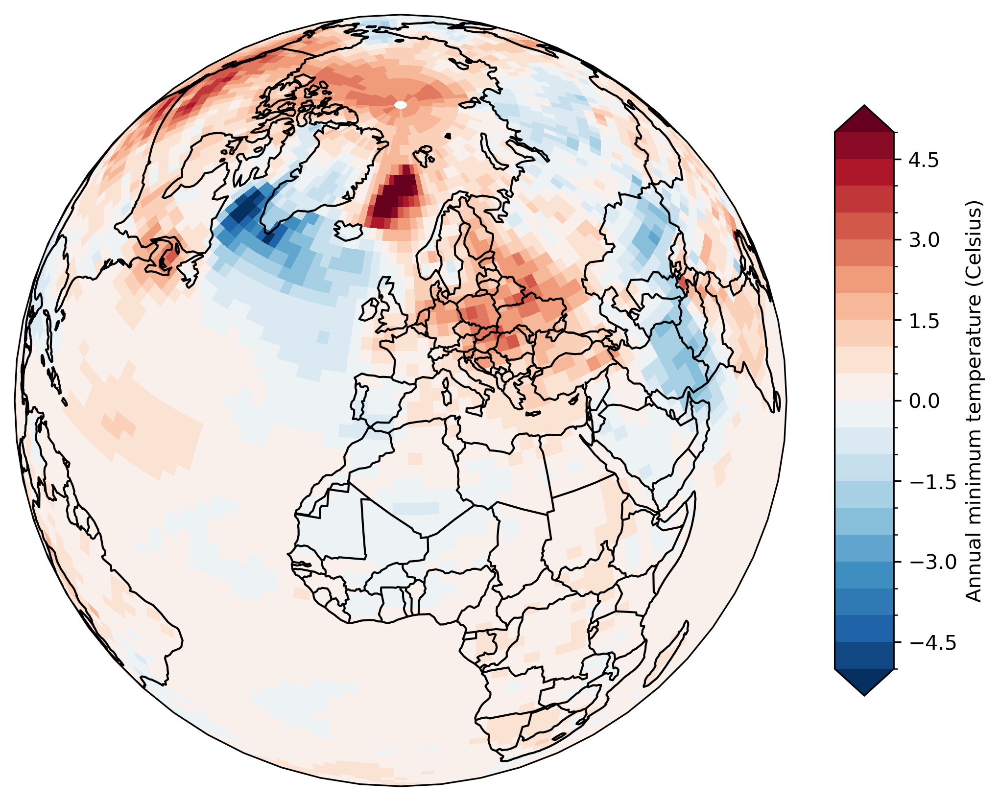

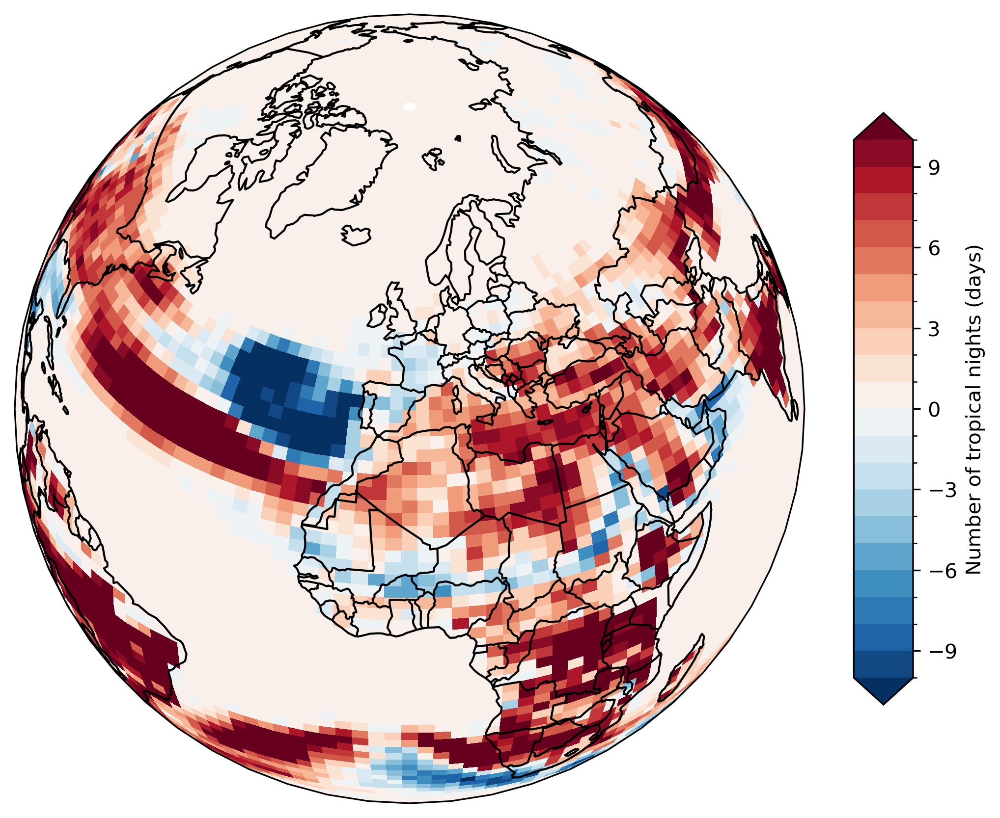

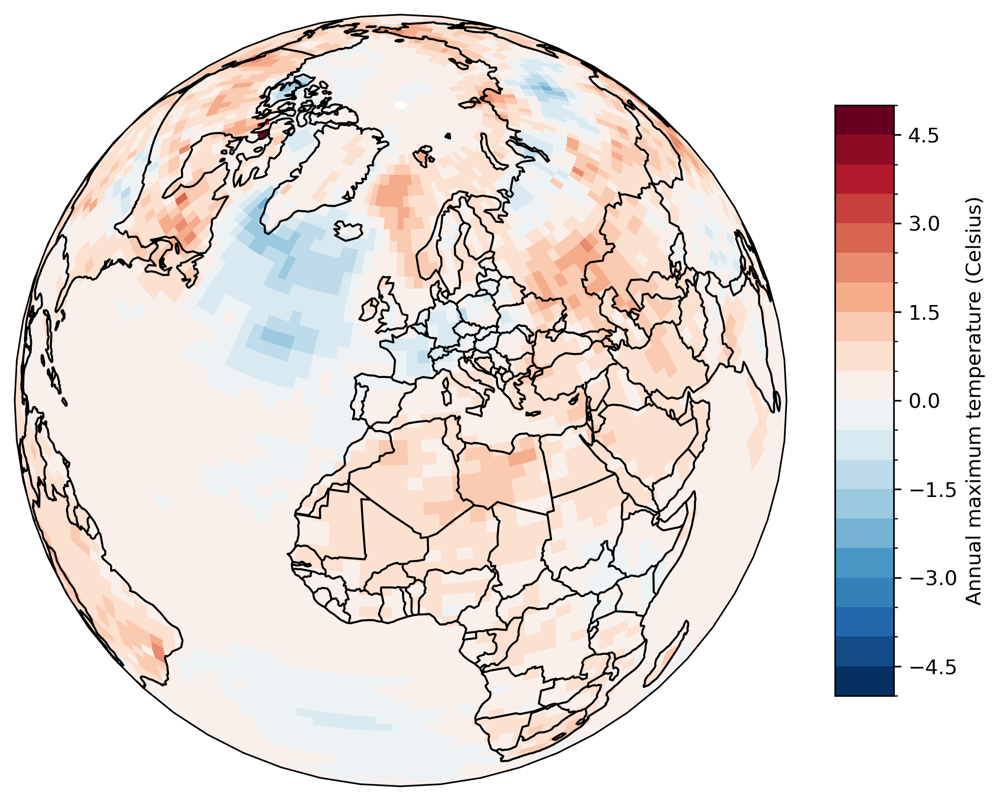

In [42]:
save_folder = '../figures/maps/globe/' # Folder where figures should be saved
os.makedirs(save_folder, exist_ok=True) 

# Choose variables

variable_list = list(clim_idx.keys())
print(variable_list)
level_list = [10, 100, 10, 50, 10, 10, 10, 50, 2, 10, 5, 10, 5] # Global mean

# Plotting

for variable, lmax in zip(variable_list, level_list):
    levels = np.linspace(-lmax, lmax, 21)
    fig = plt.figure(figsize=[7, 7], dpi=300)
    ax = plt.axes(projection=ccrs.Orthographic(0,40))
    ax.set_global()
    diff = clim_idx[variable].isel(time=slice(20,40)).mean("time") - clim_idx[variable].isel(time=slice(0,20)).mean("time")
    map = diff.plot(ax=ax, 
                transform=ccrs.PlateCarree(),levels=levels,
                cbar_kwargs={'orientation':'vertical','shrink':0.6, 'aspect':10,'label':clim_idx[variable].description +' ('+clim_idx[variable].units+')'})
    ax.coastlines()
    ax.add_feature(cFeature.BORDERS)
    fig.tight_layout()
    plt.savefig(save_folder+variable+'_'+area_name+'_'+model_scenario_name+'.png')
    plt.show()